## Variables de Instrumento de Enel. 4 años

In [1]:
import ast, json, random, argparse
import os, sys, datetime, shutil
import statistics, smtplib, ssl, re, string
import datetime, math, pickle
import pdb
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.offline as py
import plotly.express as px
#
from plotly import tools
from plotly.subplots import make_subplots
from datetime import date, timedelta

### Carga de datos

In [2]:
fich = './Datos_summary_1923_03102023.xlsx'
sheet_to_df_map = pd.read_excel(fich, sheet_name=None)
sheet_to_df_map.keys()

dict_keys(['Sheet1'])

In [3]:
odat=sheet_to_df_map['Sheet1']
odat

,index,GRLL0222FQLM1_x,GRLL0221dwattout2,GRLL0221dvar,GRLL0221TT_MES_T BP1,GRLL0221TT_MES_P_BP,GRLL0221TOTH2O,GRLL0221csgv,GRLL0221afpcs,GRLL0221CTIM,...,GRLL0220DWATT,GRLL0220DPF,GRLL0220TNH_RPM,GRLL0221TTAAC586,GRLL0222TTAAC586,GRLL-MEDAS-EMI-EMISARIO_TEMP_AMB_UA,GRLL-MEDAS-EMI-EMISARIO_PRESION_UA,GRLL0220DF,GRLL0221DF,GRLL0222DF
0,2019-09-12 00:00:00,0,0.041861,-0.107773,92.843274,1014.562318,836868864,26.309298,0.540243,30.475943,...,0.007275,1,5.6223,0,0,22.973584,1018.351358,0.093198,0.121335,0.116257
1,2019-09-12 00:10:00,0,0.04168,-0.107773,87.139139,1014.407639,836868864,26.309298,0.540243,30.549444,...,0.007275,1,5.611864,0,0,22.872396,1018.349156,0.093198,0.121335,0.116257
2,2019-09-12 00:20:00,0,0.045001,-0.107773,82.557352,1014.265748,836868864,26.309298,0.540243,30.382821,...,0.007275,1,5.606741,0,0,22.960759,1018.253283,0.093198,0.121335,0.116257
3,2019-09-12 00:30:00,0,0.046692,-0.107773,78.61093,1014.047876,836868864,26.309298,0.540243,29.792425,...,0.007275,1,5.616194,0,0,22.844276,1018.334683,0.093198,0.121335,0.116257
4,2019-09-12 00:40:00,0,0.040439,-0.107773,75.229267,1014.158248,836868864,26.309298,0.540243,29.792425,...,0.007275,1,5.618591,0,0,22.698559,1018.345932,0.093198,0.121335,0.116257
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210459,2023-09-12 23:10:00,4.024974,49.730271,2.029807,77.414982,1012.959066,1303286850.331875,62.412089,112.667617,27.572483,...,56.830961,0.250464,3000.261968,100,100,24.431391,1017.719256,50.007584,50.023406,50.001535
210460,2023-09-12 23:20:00,4.063264,50.422663,1.590955,77.097834,1012.973495,1303289451.605483,61.932667,111.538281,27.530417,...,57.235486,0.147266,3000.584207,100,100,24.26028,1017.72508,50.009199,50.021606,50.007504
210461,2023-09-12 23:30:00,3.950957,48.17391,1.137557,75.076112,1013.051452,1303291958.556297,61.044968,109.708542,27.623137,...,56.229975,0.044067,3000.396365,100,100,24.265218,1017.786045,50.011282,50.013791,49.997962
210462,2023-09-12 23:40:00,3.910528,47.338156,0.818587,75.513928,1013.09052,1303294384.027383,60.243865,107.340495,27.616187,...,55.522513,-0.059131,2999.971347,100,100,24.49856,1017.863232,50.022529,49.98558,49.96864


In [4]:
odat.columns

Index(['index', 'GRLL0222FQLM1_x', 'GRLL0221dwattout2', 'GRLL0221dvar',
       'GRLL0221TT_MES_T BP1', 'GRLL0221TT_MES_P_BP', 'GRLL0221TOTH2O',
       'GRLL0221csgv', 'GRLL0221afpcs', 'GRLL0221CTIM', 'GRLL0221CPD',
       'GRLL0221CTDA', 'GRLL0221TTRF1', 'GRLL0221TTXM', 'GRLL0221TTXSP1',
       'GRLL0221TTXSPL', 'GRLL0221BBA10GS511ET16R', 'GRLL0221tnh_v',
       'GRLL0222FQLM1_y', 'GRLL0222dwatt', 'GRLL0222dvar',
       'GRLL0222TT_MES_T BP2', 'GRLL0222TT_MES_P_BP', 'GRLL0222TOTH2O',
       'GRLL0222csgv', 'GRLL0222afpcs', 'GRLL0222CTIM', 'GRLL0222CPD',
       'GRLL0222CTDA', 'GRLL0222TTRF1', 'GRLL0222TTXM', 'GRLL0222TTXSP1',
       'GRLL0222TTXSPL', 'GRLL0222BBA10GS521ET16R', 'GRLL0222tnh_v',
       'GRLL0221LAP50CF001XZ01A', 'GRLL0221LCA90CF001XZ01_A',
       'GRLL0221LBA10CF001XZ01A', 'GRLL0221LBD10CF001XZ01A',
       'GRLL0221LAE01CF001XZ01A', 'GRLL0220cv1_pos_x', 'GRLL0220acv1_pos_x',
       'GRLL0220IP_P', 'GRLL0220TT_IS', 'GRLL0221HNA20CT401JT01A',
       'GRLL0221TT_MES_T HRSG1

In [5]:
fich2 = './Tabla_Maestra_Jerarquia.xlsx'
sheet_to_df_map = pd.read_excel(fich2, sheet_name=None)
sheet_to_df_map.keys()
varindx = sheet_to_df_map['Hoja2']
varindx

,TAG,GLOBAL CODE DESC,AGRUPACION,DESCRIPCION,UNIDAD,TIPO DE MEDIDA
0,GRLL0221FQLM1,GRAN-GT21-CC-2x1,TG1,CAUDAL MASICO COMBUSTIBLE,kg/s,CAUDAL
1,GRLL0221dwattout2,GRAN-GT21-CC-2x1,TG1,POTENCIA ACTIVA,MW,POTENCIA
2,GRLL0221dvar,GRAN-GT21-CC-2x1,TG1,POTENCIA REACTIVA,Mvar,POTENCIA
3,GRLL0221TT_MES_T BP1,GRAN-GT21-CC-2x1,TG1,TEMPERATURA SALIDA CHIMENEA BYPASS,degC,TEMPERATURA
4,GRLL0221TT_MES_P_BP,GRAN-GT21-CC-2x1,TG1,PRESION SALIDA CHIMENEA BYPASS,bara,PRESION
...,...,...,...,...,...,...
69,GRLL0220TNH_RPM,GRAN-ST21-CC-2x1,CICLO,VELOCIDAD ROTOR TURBINA DE VAPOR,rpm,VELOCIDAD
70,GRLL0221TTAAC586,GRAN-ST21-CC-2x1,CICLO,POSICION DIVERTER CALDERA,%,POSICION
71,GRLL0222TTAAC586,GRAN-ST21-CC-2x1,CICLO,POSICION DIVERTER CALDERA,%,POSICION
72,GRLL-MEDAS-EMI-EMISARIO_TEMP_AMB_UA,NaN,NaN,TEMPERATURA AMBIENTE MEDIDA METEOROLOGICA CENTRAL,degC,TEMPERATURA


In [6]:
varindx['AGRUPACION'].unique()

array(['TG1', 'HRSG1', 'CICLO', 'HRSG2', nan], dtype=object)

In [7]:
idx = odat[odat['GRLL0222FQLM1_x'].apply(lambda x: isinstance(x,str))].index
print('Antes:')
print(odat.loc[idx,'GRLL0222FQLM1_x'])
if len(idx) > 0:
    dat = odat.drop(index=idx)
    dat['GRLL0222FQLM1_x'] = dat['GRLL0222FQLM1_x'].astype(float)
#
print('Después:')
idx = dat[dat['GRLL0222FQLM1_x'].apply(lambda x: isinstance(x,str))].index
print(dat.loc[idx,'GRLL0222FQLM1_x'])

Antes:
29284     [-11059] No Good Data For Calculation
29285     [-11059] No Good Data For Calculation
29286     [-11059] No Good Data For Calculation
29287     [-11059] No Good Data For Calculation
29288     [-11059] No Good Data For Calculation
                          ...                  
196575    [-11059] No Good Data For Calculation
196576    [-11059] No Good Data For Calculation
196577    [-11059] No Good Data For Calculation
197558    [-11059] No Good Data For Calculation
197559    [-11059] No Good Data For Calculation
Name: GRLL0222FQLM1_x, Length: 85, dtype: object
Después:
Series([], Name: GRLL0222FQLM1_x, dtype: float64)


In [8]:
for k in dat.columns:
    idx = dat[dat[k].apply(lambda x: isinstance(x,str))].index
    if len(idx) > 0:
        print('Var: '+k + ' => ' + str(len(idx)))
        dat = dat.drop(index=idx)
        dat[k] = dat[k].astype(float)
    else:
        if k != 'index':
            dat[k] = dat[k].astype(float)
dat.shape

Var: GRLL0221dwattout2 => 1
Var: GRLL0221dvar => 191
Var: GRLL0221TT_MES_T BP1 => 1
Var: GRLL0221TOTH2O => 288
Var: GRLL0221afpcs => 31
Var: GRLL0221CTIM => 1
Var: GRLL0221CTDA => 7
Var: GRLL0221TTRF1 => 378
Var: GRLL0221BBA10GS511ET16R => 8331
Var: GRLL0222dvar => 1025
Var: GRLL0222TT_MES_T BP2 => 5
Var: GRLL0222TOTH2O => 56
Var: GRLL0222csgv => 1
Var: GRLL0222TTXSP1 => 2
Var: GRLL0221LAP50CF001XZ01A => 24
Var: GRLL0220cv1_pos_x => 15
Var: GRLL0220TT_IS => 7
Var: GRLL0222LBA10CF001XZ01A => 17
Var: GRLL0222LBD10CF001XZ01A => 1
Var: GRLL0220LCC01CT004JT01A => 26
Var: GRLL-MEDAS-EMI-EMISARIO_TEMP_AMB_UA => 1248


(198723, 77)

In [9]:
dat.dtypes

index                                  datetime64[ns]
GRLL0222FQLM1_x                               float64
GRLL0221dwattout2                             float64
GRLL0221dvar                                  float64
GRLL0221TT_MES_T BP1                          float64
                                            ...      
GRLL-MEDAS-EMI-EMISARIO_TEMP_AMB_UA           float64
GRLL-MEDAS-EMI-EMISARIO_PRESION_UA            float64
GRLL0220DF                                    float64
GRLL0221DF                                    float64
GRLL0222DF                                    float64
Length: 77, dtype: object

In [10]:
#
# En varindex hay entradas _x y _y que no sabemos qué hacen pero que no encajan con los datos
# Variables de datos que no están en la tabla de Jerarquía (después de quitar los _x e _y
for j in range(1,len(dat.columns)):
    txtj = dat.columns[j]
    idx  = (varindx['TAG'] == txtj)
    ldx  = len(varindx['TAG'].index[idx])
    if ldx == 0:
        print('Var no encontrada {}'.format(txtj))

Var no encontrada GRLL0222FQLM1_y
Var no encontrada GRLL0220cv1_pos_y
Var no encontrada GRLL0220acv1_pos_y


In [11]:
# Variables de la tabla de Jerarquía que no están en los datos.
lkeys = '|'.join(dat.columns[1:])
result = varindx.loc[~varindx['TAG'].str.contains(lkeys, case=False)]
result['TAG']

0    GRLL0221FQLM1
Name: TAG, dtype: object

In [12]:
list(set(dat.columns[1:])-set(varindx.TAG))

['GRLL0220acv1_pos_y', 'GRLL0220cv1_pos_y', 'GRLL0222FQLM1_y']

In [13]:
lcls= list(set(dat.columns[1:])-set(varindx.TAG))
#

In [14]:
# varindx['TAG'] = varindx['TAG'].str.replace('_x$','').str.replace('_y$','')
# Error Conduce a columnas duplicadas

# lcls = dat.columns.tolist()
# nlcs = [re.sub('_y$','',re.sub('_x$','',j)) for j in lcls]
# dat.columns = nlcs
# 
# Podamos de dat las columnas con _x e _y
dat   = dat.loc[:,list(set(dat.columns)-set(lcls))]
c2mov = dat.pop('index')
dat.insert(0,'index',c2mov)

In [16]:
# Variables de datos que no están en la tabla de Jerarquía (después de quitar los _x e _y
for j in range(1,len(dat.columns)):
    txtj = dat.columns[j]
    idx  = (varindx['TAG'] == txtj)
    ldx  = len(varindx['TAG'].index[idx])
    if ldx == 0:
        print('Var no encontrada {}'.format(txtj))

In [17]:
# Variables de la tabla de Jerarquía que no están en los datos.
lkeys = '|'.join(dat.columns[1:])
result = varindx.loc[~varindx['TAG'].str.contains(lkeys, case=False)]
result['TAG']

0    GRLL0221FQLM1
Name: TAG, dtype: object

In [15]:
dat.columns

Index(['index', 'GRLL0221CPD', 'GRLL0220PAB32CT007JT01A', 'GRLL0220DF',
       'GRLL0221LAP30CF001XZ01A', 'GRLL0221DF', 'GRLL0221CTIM',
       'GRLL0222LAP50CF001XZ01A', 'GRLL0222CTIM', 'GRLL0222LBA10CF001XZ01A',
       'GRLL0221afpcs', 'GRLL0221TT_MES_T HRSG1', 'GRLL0220cv1_pos_x',
       'GRLL0220PAB31CT002JT01A', 'GRLL0220IP_P', 'GRLL0220DPF',
       'GRLL0221dvar', 'GRLL0221TOTH2O', 'GRLL0220LCA80CF001XW01',
       'GRLL0222HNA20CT401JT01A', 'GRLL0220LCR01CL002XW01', 'GRLL0222TTXSP1',
       'GRLL022pt_203', 'GRLL0221tnh_v', 'GRLL0222LAE01CF001XZ01A',
       'GRLL0221TTXSPL', 'GRLL-MEDAS-EMI-EMISARIO_PRESION_UA',
       'GRLL0222LBD10CF001XZ01A', 'GRLL0222TT_MES_T BP2', 'GRLL0222DF',
       'GRLL0221TTXSP1', 'GRLL0222CTDA', 'GRLL0222TTXSPL',
       'GRLL0221TT_MES_T BP1', 'GRLL0222dwatt', 'GRLL0221TTRF1',
       'GRLL0220PAB32CT002JT01A', 'GRLL0221TT_MES_P_BP', 'GRLL0222dvar',
       'GRLL0222CPD', 'GRLL0222TT_MES_T HRSG2', 'GRLL0222TTRF1',
       'GRLL0222TOTH2O', 'GRLL0222BBA10GS

In [26]:
# Como consecuencia quitamos de varindx la fila de TAG=GRLL0221FQLM1
# Dropping the variable
varidx = varindx[varindx["TAG"].str.contains("GRLL0221FQLM1") == False] 
varindx= varidx.copy()

 ## Segmentación por sistemas

### Subsistema TG1

In [27]:
idx = varindx['AGRUPACION'].isna()
varindx.loc[idx,'AGRUPACION'] = 'ALL'
idx = varindx['UNIDAD'].isna()
varindx.loc[idx,'UNIDAD'] = 'N/A'
varindx['AGRUPACION'].unique()

array(['TG1', 'HRSG1', 'CICLO', 'HRSG2', 'ALL'], dtype=object)

In [28]:
nname   = varindx.loc[varindx['AGRUPACION'].isin(['TG1','ALL']),['TAG','AGRUPACION','DESCRIPCION','UNIDAD']]
nname['NNORM'] = nname['DESCRIPCION'].str.replace(' ','_')+':'+nname['UNIDAD']
# Nombres explicativos de las varaibles creados
dat_unt = dat.loc[:,['index']+nname['TAG'].tolist()]
dat_unt.columns

Index(['index', 'GRLL0221dwattout2', 'GRLL0221dvar', 'GRLL0221TT_MES_T BP1',
       'GRLL0221TT_MES_P_BP', 'GRLL0221TOTH2O', 'GRLL0221csgv',
       'GRLL0221afpcs', 'GRLL0221CTIM', 'GRLL0221CPD', 'GRLL0221CTDA',
       'GRLL0221TTRF1', 'GRLL0221TTXM', 'GRLL0221TTXSP1', 'GRLL0221TTXSPL',
       'GRLL0221BBA10GS511ET16R', 'GRLL0221tnh_v', 'GRLL0221DF',
       'GRLL0221LAP50CF001XZ01A', 'GRLL0221LCA90CF001XZ01_A',
       'GRLL0221LBA10CF001XZ01A', 'GRLL0221LBD10CF001XZ01A',
       'GRLL0221LAE01CF001XZ01A', 'GRLL0220cv1_pos_x', 'GRLL0220acv1_pos_x',
       'GRLL0220IP_P', 'GRLL0220TT_IS', 'GRLL0221HNA20CT401JT01A',
       'GRLL0221TT_MES_T HRSG1', 'GRLL0221LAP30CF001XZ01A',
       'GRLL-MEDAS-EMI-EMISARIO_TEMP_AMB_UA',
       'GRLL-MEDAS-EMI-EMISARIO_PRESION_UA'],
      dtype='object')

In [29]:
def var_map(j,nname):
    if j == 'index':
        return('Time:ISO')
    return(nname.loc[nname['TAG']==j,'NNORM'].tolist()[0])
newnms = [ var_map(j,nname) for j in dat_unt.columns]
dat_unt.columns = newnms
dat_unt.columns

Index(['Time:ISO', 'POTENCIA_ACTIVA:MW', 'POTENCIA_REACTIVA:Mvar',
       'TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC',
       'PRESION_SALIDA_CHIMENEA_BYPASS:bara',
       'TOTALIZADOR_INYECCION_DE_AGUA:kg', 'POSICION_IGV:degC',
       'CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg',
       'TEMPERATURA_ENTRADA_AIRE_COMPRESOR:degC',
       'PRESIÐ£N_DESCARGA_COMPRESOR:barg',
       'TEMPERATURA_DESCARGA_COMPRESOR:degC',
       'TEMPERATURA_REFERENCIA_CONTROL_COMBUSTION:degC',
       'TEMPERATURA_ESCAPE_TURBINA:degC',
       'PRIMER_NIVEL_DISPERSION_TEMPERATURAS_ESCAPE:degC',
       'NIVEL_DE_DISPERSION_MAXIMO_PERMITIDO:degC',
       'FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A',
       'VELOCIDAD_ROTOR_TURBINA_GAS:rpm', 'FRECUENCIA_DE_GENERACION:Hz',
       'CAUDAL_AGUA_ALIMENTACION_AP:Tn/h',
       'CAUDAL_AGUA_CONDENSADO_A_ECONOMIZADOR_BP:Tn/h',
       'CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h',
       'CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_BP:Tn/h',
       'CAUDAL_ATEMPERACION_SOBR

/usr/local/lib/python3.11/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



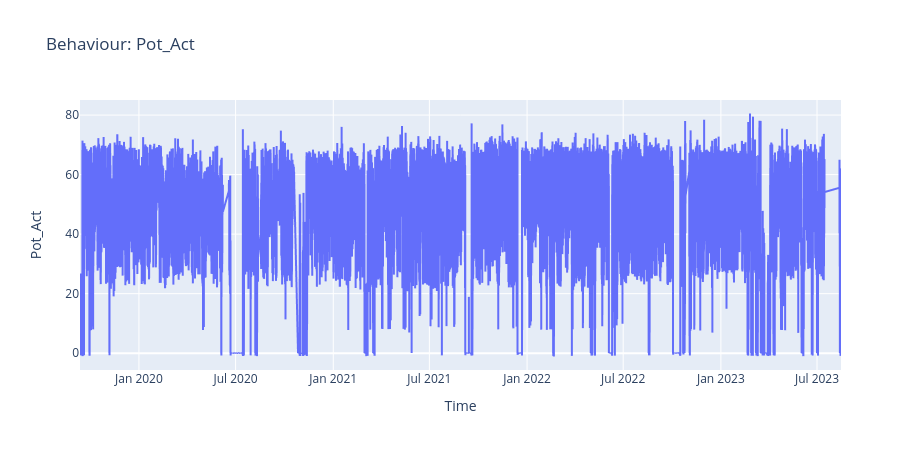

In [30]:
kvr1=dat_unt[['Time:ISO','POTENCIA_ACTIVA:MW','TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC']]
kvr1.columns=['Time','Pot_Act','T_chim']
fig = px.line(kvr1, x = "Time", y = "Pot_Act", 
             width=800, height=450,title="Behaviour: Pot_Act")  # ,hover_data=['id','t'],
fig.update_traces(connectgaps=False)
fig.show()

### Preparación de Datos

In [31]:
# Se toma la serie desde el inicio hasta el 27/3/2023 como criterio para entrenamiento
# Después test.
lngcut = datetime.datetime.strptime('2023-03-27 00:00:00',"%Y-%m-%d %H:%M:%S")
DFtrain= dat_unt.loc[dat_unt['Time:ISO'] < lngcut,list(set(dat_unt.columns) - 
                                                       set(['Time:ISO']))]
DFtest = dat_unt.loc[dat_unt['Time:ISO'] >= lngcut,list(set(dat_unt.columns) - 
                                                       set(['Time:ISO']))]
DFtrain.columns

Index(['CAUDAL_TOTAL_AGUA_ALIMENTACION:Tn/h',
       'FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A',
       'CAUDAL_AGUA_ALIMENTACION_AP:Tn/h', 'POTENCIA_ACTIVA:MW',
       'CAUDAL_ATEMPERACION_SOBRECALENTADO_AP:Tn/h',
       'TEMPERATURA_REFERENCIA_CONTROL_COMBUSTION:degC',
       'TEMPERATURA_DESCARGA_COMPRESOR:degC', 'FRECUENCIA_DE_GENERACION:Hz',
       'POSICION_VALVULA_CONTROL_VAPOR_PRINCIPAL_TURBINA_BP:%',
       'VELOCIDAD_ROTOR_TURBINA_GAS:rpm',
       'PRESION_VAPOR_PRINCIPAL_TURBINA_AP:bar',
       'CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg',
       'CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h',
       'TEMPERATURA_ESCAPE_TURBINA:degC',
       'TEMPERATURA_AMBIENTE_MEDIDA_METEOROLOGICA_CENTRAL:degC',
       'PRIMER_NIVEL_DISPERSION_TEMPERATURAS_ESCAPE:degC',
       'CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_BP:Tn/h',
       'TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC',
       'NIVEL_DE_DISPERSION_MAXIMO_PERMITIDO:degC',
       'TEMPERATURA_VAPOR_PRINCIPAL_TURBINA_AP:degC',
     

In [32]:
print(DFtrain.shape)
DFtrain.dropna()
print(DFtrain.shape)


(182518, 31)
(182518, 31)


## Train with AutoML

In [33]:
import h2o
from h2o.automl import H2OAutoML
h2o.init()
#
h2o_frame = h2o.H2OFrame(DFtrain)
x = h2o_frame.columns
y = 'POTENCIA_ACTIVA:MW'
x.remove(y)
#
h2o_automl = H2OAutoML(sort_metric='mse', max_runtime_secs=30*60, seed=666)
h2o_automl.train(x=x, y=y, training_frame=h2o_frame)

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.20.1" 2023-08-24; OpenJDK Runtime Environment (build 11.0.20.1+1-post-Ubuntu-0ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.20.1+1-post-Ubuntu-0ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.11/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmplq9bv3e9
  JVM stdout: /tmp/tmplq9bv3e9/h2o_jb_started_from_python.out
  JVM stderr: /tmp/tmplq9bv3e9/h2o_jb_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,01 secs
H2O_cluster_timezone:,Europe/Madrid
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.42.0.4
H2O_cluster_version_age:,9 days
H2O_cluster_name:,H2O_from_python_jb_umla00
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,29.97 Gb
H2O_cluster_total_cores:,6
H2O_cluster_allowed_cores:,6
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),4/12
# GBM base models (used / total),3/5
# XGBoost base models (used / total),1/3
# DRF base models (used / total),0/2
# DeepLearning base models (used / total),0/1
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5


In [34]:
h2o_models = h2o.automl.get_leaderboard(h2o_automl, extra_columns = "ALL")
h2o_models

model_id,mse,rmse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_2_AutoML_1_20231012_173411,0.207325,0.455329,0.255449,nan,0.207325,1359,0.086801,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20231012_173411,0.207328,0.455332,0.255441,nan,0.207328,1248,0.086355,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_1_20231012_173411,0.207412,0.455425,0.255681,nan,0.207412,998,0.064733,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20231012_173411,0.207533,0.455558,0.255988,nan,0.207533,1029,0.066864,StackedEnsemble
StackedEnsemble_BestOfFamily_1_AutoML_1_20231012_173411,0.207609,0.455641,0.256346,nan,0.207609,1169,0.063553,StackedEnsemble
StackedEnsemble_AllModels_3_AutoML_1_20231012_173411,0.209838,0.458081,0.259071,nan,0.209838,1280,0.082453,StackedEnsemble
GBM_1_AutoML_1_20231012_173411,0.212617,0.461104,0.257758,nan,0.212617,93847,0.061977,GBM
GBM_4_AutoML_1_20231012_173411,0.246465,0.496452,0.277149,nan,0.246465,23624,0.01334,GBM
GBM_3_AutoML_1_20231012_173411,0.266605,0.516338,0.299309,nan,0.266605,22969,0.016658,GBM
GBM_2_AutoML_1_20231012_173411,0.293397,0.541662,0.320497,nan,0.293397,22482,0.01747,GBM


## Predicción sobre el conjunto de test (Datos no vistos antes)

In [35]:
from h2o.model.regression import h2o_mean_squared_error

h2o_frame_test = h2o.H2OFrame(DFtest)

y_pred = h2o_automl.predict(h2o_frame_test)
y_actual = h2o.H2OFrame(DFtest[[y]])

h2o_mean_squared_error(y_actual, y_pred)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


0.8109271861578051

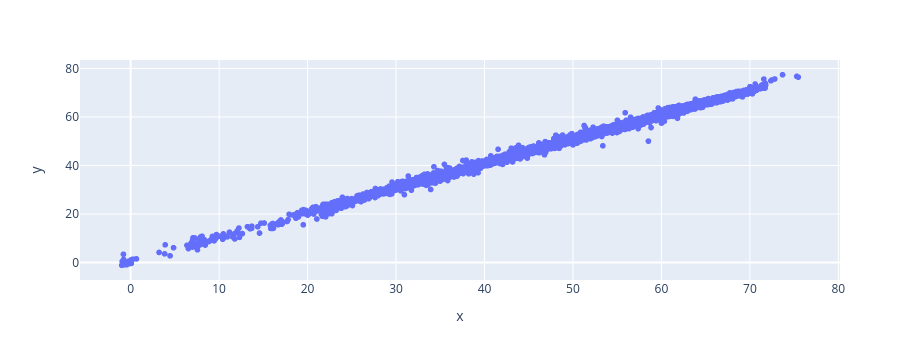

In [36]:
h2o_compare = pd.DataFrame(data={'actual': DFtest[y], 'predicted': y_pred.as_data_frame().to_numpy().ravel()})
# h2o_compare.plot(figsize=(10, 5))
import plotly.express as px
fig = px.scatter(x=h2o_compare['actual'], y=h2o_compare['predicted'])
fig.show()

In [37]:
h2o_compare

,actual,predicted
185989,0.048870,0.097324
185990,0.049962,0.134737
185991,0.050911,0.135108
185992,0.049952,-0.004055
185993,0.048980,-0.005881
...,...,...
206315,0.052398,0.032535
206316,0.049099,0.044854
206317,0.048688,0.026214
206318,0.047660,0.041345


In [38]:
varimp = h2o_automl.varimp(use_pandas=True)

In [39]:
varimp

,GBM_grid_1_model_1,XGBoost_1,GBM_3,GBM_5,XGBoost_grid_1_model_1,XGBoost_3,GBM_2,GBM_4,GBM_1,XRT_1,XGBoost_2,XGBoost_grid_1_model_2,GLM_1,DeepLearning_grid_1_model_1,DeepLearning_1,DRF_1
PRESIÐ£N_DESCARGA_COMPRESOR:barg,0.346055,0.583708,0.600596,0.553078,0.544628,0.826356,0.707075,0.677624,0.771037,0.111683,0.150350,0.205252,0.067857,0.036508,0.061657,0.285703
TEMPERATURA_ESCAPE_TURBINA:degC,0.137587,0.089641,0.092332,0.011349,0.010866,0.008194,0.007303,0.047889,0.035617,0.372557,0.376444,0.013623,0.117141,0.035723,0.062596,0.127917
POSICION_IGV:degC,0.331189,0.000214,0.030752,0.018294,0.030579,0.000362,0.001323,0.048053,0.000595,0.001941,0.103235,0.001035,0.072867,0.031938,0.048624,0.005377
CAUDAL_AGUA_CONDENSADO_A_ECONOMIZADOR_BP:Tn/h,0.011487,0.021204,0.021321,0.017950,0.055523,0.015370,0.015878,0.020977,0.012480,0.017206,0.012988,0.026243,0.041255,0.038092,0.048169,0.020243
CAUDAL_AGUA_ALIMENTACION_AP:Tn/h,0.003812,0.001425,0.003880,0.002869,0.001216,0.001572,0.007758,0.002578,0.006082,0.002058,0.021003,0.006174,0.000250,0.035964,0.037716,0.032273
PRIMER_NIVEL_DISPERSION_TEMPERATURAS_ESCAPE:degC,0.008649,0.009990,0.007248,0.005719,0.012882,0.009489,0.006108,0.011073,0.010823,0.009030,0.003564,0.000000,0.004748,0.031389,0.016308,0.003456
TEMPERATURA_GASES_ESCAPE_ENTRADA_CALDERA:degC,0.000845,0.000539,0.001075,0.001670,0.000381,0.000509,0.000418,0.000603,0.001480,0.000520,0.000513,0.000339,0.011759,0.028590,0.039872,0.001655
TEMPERATURA_VAPOR_PRINCIPAL_TURBINA_AP:degC,0.000034,0.000062,0.000020,0.000019,0.000012,0.000129,0.000041,0.000033,0.000043,0.000367,0.000051,0.000000,0.009412,0.036292,0.044527,0.000065
TEMPERATURA_AMBIENTE_MEDIDA_METEOROLOGICA_CENTRAL:degC,0.000290,0.000143,0.000108,0.000120,0.000155,0.000048,0.000123,0.000119,0.000138,0.000142,0.000084,0.000026,0.001340,0.035806,0.021339,0.000153
CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_BP:Tn/h,0.000380,0.000185,0.000159,0.000235,0.000169,0.000092,0.000320,0.000139,0.000216,0.000171,0.000262,0.000033,0.000834,0.033049,0.032828,0.000204


In [40]:
bm = h2o_automl.leader
metalearner = h2o.get_model(h2o_automl.leader.metalearner().model_id)
metalearner

,family,link,regularization,number_of_predictors_total,number_of_active_predictors,number_of_iterations,training_frame
,gaussian,identity,"Elastic Net (alpha = 0.5, lambda = 0.6871 )",12,4,1,levelone_training_StackedEnsemble_AllModels_2_AutoML_1_20231012_173411
,mean,sd,cv_1_valid,cv_2_valid,cv_3_valid,cv_4_valid,cv_5_valid
mae,0.2554392,0.0020172,0.2577858,0.2556868,0.2569217,0.2530848,0.2537168
mean_residual_deviance,0.2073254,0.0127809,0.2211785,0.2186771,0.1933768,0.2078100,0.1955848
mse,0.2073254,0.0127809,0.2211785,0.2186771,0.1933768,0.2078100,0.1955848
null_deviance,12515609.0000000,87312.875,12575302.0000000,12551823.0000000,12580273.0000000,12369953.0000000,12500693.0000000
r2,0.9993953,0.0000368,0.9993555,0.9993634,0.9994345,0.999392,0.9994311
residual_deviance,7568.102,469.8164,8103.9785,7990.462,7114.526,7521.059,7110.4844
rmse,0.4551566,0.0140476,0.4702961,0.4676292,0.4397463,0.4558618,0.4422497
rmsle,nan,0.0,nan,nan,nan,nan,nan


In [41]:
perf = bm.model_performance(h2o_frame_test)
perf

ModelMetricsRegressionGLM: stackedensemble
** Reported on test data. **

MSE: 0.8109271903340555
RMSE: 0.900514958417713
MAE: 0.7105982362209476
RMSLE: NaN
Mean Residual Deviance: 0.8109271903340555
R^2: 0.9982299930507242
Null degrees of freedom: 16204
Residual degrees of freedom: 16200
Null deviance: 7624902.539542699
Residual deviance: 13141.07511936337
AIC: 42603.60247023363

In [42]:
#
h2o.save_model(model=bm, path='./models/', force=True)

'/home/jb/notebooks/Enel/Gas/Granadilla/models/StackedEnsemble_AllModels_2_AutoML_1_20231012_173411'

## Modelos con menos parámetros

In [43]:
from h2o.estimators import H2OModelSelectionEstimator
sweepModel = H2OModelSelectionEstimator(mode="backward", # backward, maxr, maxrsweep, allsubsets
                                        # build_glm_model=False,
                                        max_predictor_number=5,
                                        seed=666)
sweepModel.train(x=x, y=y, training_frame=h2o_frame)

modelselection Model Build progress: |███████████████████████████████████████████| (done) 100%


,coefficient_names,predictor_names,z_values,p_values,predictors_removed
with 1 predictors,"CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, Intercept",CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg,"1320.0035593718485, -167.48419925454112","0.0, 0.0",CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg
with 2 predictors,"FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, Intercept","FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg","-313.4306275231659, 1013.250768788818, -78.65130301489341","0.0, 0.0, 0.0",FRECUENCIA_DE_GENERACION:Hz
with 3 predictors,"FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, Intercept","FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h","-342.6481986460336, 833.7235302173365, 206.23456545343592, -86.1648527520693","0.0, 0.0, 0.0, 0.0",CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h
with 4 predictors,"FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, Intercept","FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC","-575.7920165010507, 543.0231142038305, 436.79862255017076, 363.3405036418724, -213.24551858194633","0.0, 0.0, 0.0, 0.0, 0.0",TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC
with 5 predictors,"FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, POSICION_IGV:degC, Intercept","FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, POSICION_IGV:degC","-595.0939895157403, 333.5757458396286, 414.5257906950211, 342.4171003789604, 156.71812382891633, -235.6357331226762","0.0, 0.0, 0.0, 0.0, 0.0, 0.0",POSICION_IGV:degC
with 6 predictors,"FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_ESCAPE_TURBINA:degC, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, POSICION_IGV:degC, Intercept","FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_ESCAPE_TURBINA:degC, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, POSICION_IGV:degC","-447.9165158714544, 382.7256779824928, 208.85383942449562, 162.3343847623702, 188.26312268671376, 182.1912262615703, -276.6967373453837","0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0",TEMPERATURA_ESCAPE_TURBINA:degC
with 7 predictors,"FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A, FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_ESCAPE_TURBINA:degC, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, POSICION_IGV:degC, Intercept","FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A, FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_ESCAPE_TURBINA:degC, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, POSICION_IGV:degC","-67.70541886330084, -455.18160308682263, 362.43272735069775, 210.68665531678988, 173.66881278392572, 190.00694217612306, 194.79926459467774, -256.4280942638364","0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0",FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A
with 8 predictors,"FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A, FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h, TEMPERATURA_ESCAPE_TURBINA:degC, TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC, PRESIÐ£N_DESCARGA_COMPRESOR:barg, POSICION_IGV:degC, Intercept","FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A, FRECUENCIA_DE_GENERACION:Hz, CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg, CAUDAL_VAPOR_

In [44]:
#
# Identificamos las X variables en combinación más relevantes
#
# Con 6 el RSME es de 2,38 MW
# Con 10 el RMSE es de 0,82 MW
bcoef = sweepModel.coef()[9]
bcoef

{'Intercept': -3.896525427402665,
 'FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A': -9.333958935769623,
 'TEMPERATURA_DESCARGA_COMPRESOR:degC': -0.04343230275098093,
 'FRECUENCIA_DE_GENERACION:Hz': -1.1291465682178357,
 'CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg': 0.24770761958606408,
 'CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h': 0.2798850848782097,
 'TEMPERATURA_ESCAPE_TURBINA:degC': 0.06949209557570338,
 'TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC': 0.050089824592876885,
 'PRESIÐ£N_DESCARGA_COMPRESOR:barg': 1.364806782685992,
 'TEMPERATURA_ENTRADA_AIRE_COMPRESOR:degC': -0.16664588418027343,
 'POSICION_IGV:degC': 0.4206087324588423}

In [45]:
lclsR = list(bcoef.keys())[1:]
lclsR

['FACTOR_POTENCIA_ALIMENTACION_BARRAS_MT:N/A',
 'TEMPERATURA_DESCARGA_COMPRESOR:degC',
 'FRECUENCIA_DE_GENERACION:Hz',
 'CAIDA_PRESION_FILTROS_ENTRADA_COMPRESOR:barg',
 'CAUDAL_VAPOR_VAPOR_PRINCIPAL__TURBINA_AP:Tn/h',
 'TEMPERATURA_ESCAPE_TURBINA:degC',
 'TEMPERATURA_SALIDA_CHIMENEA_BYPASS:degC',
 'PRESIÐ£N_DESCARGA_COMPRESOR:barg',
 'TEMPERATURA_ENTRADA_AIRE_COMPRESOR:degC',
 'POSICION_IGV:degC']

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
0.7633177822717118


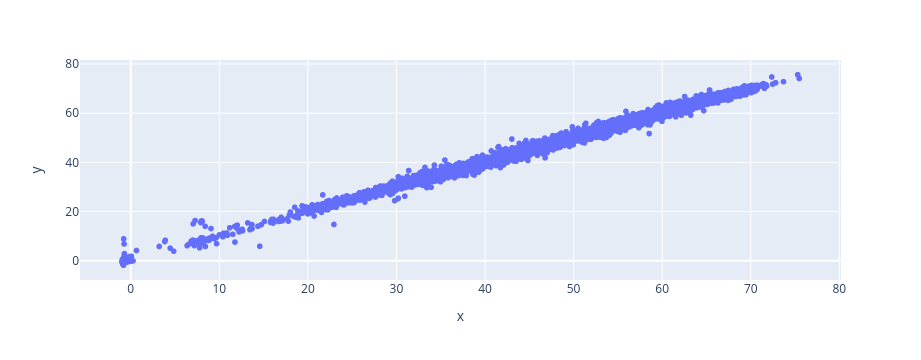

In [46]:
dat_untR = dat_unt[['Time:ISO','POTENCIA_ACTIVA:MW']+lclsR]
#
DFtrainR= dat_untR.loc[dat_untR['Time:ISO'] < lngcut,list(set(dat_untR.columns) - 
                                                       set(['Time:ISO']))]
DFtestR = dat_untR.loc[dat_untR['Time:ISO'] >= lngcut,list(set(dat_untR.columns) - 
                                                       set(['Time:ISO']))]
#
h2o_frameR = h2o.H2OFrame(DFtrainR)
x = h2o_frameR.columns
y = 'POTENCIA_ACTIVA:MW'
x.remove(y)
#
h2o_automlR = H2OAutoML(sort_metric='mse', max_runtime_secs=15*60, seed=666)
h2o_automlR.train(x=x, y=y, training_frame=h2o_frameR)
h2o_frame_testR = h2o.H2OFrame(DFtestR)
y_pred = h2o_automlR.predict(h2o_frame_testR)
y_actual = h2o.H2OFrame(DFtestR[[y]])
print(h2o_mean_squared_error(y_actual, y_pred))
#
h2o_compareR = pd.DataFrame(data={'actual': DFtestR[y], 
                                  'predicted': y_pred.as_data_frame().to_numpy().ravel()})
# h2o_compare.plot(figsize=(10, 5))
fig = px.scatter(x=h2o_compareR['actual'], y=h2o_compareR['predicted'])
fig.show()
#

# Posibilidades del Reservoir Computing

In [49]:
from sklearn.preprocessing import StandardScaler
#
dat_tmp= dat_unt.loc[:,list(set(dat_unt.columns) - set(['Time:ISO']))]
# target in y variable
c2mov  = dat_tmp.pop(y)
dat_tmp.insert(len(dat_tmp.columns),y,c2mov)
#
scaler = StandardScaler()
normalized_df = pd.DataFrame(scaler.fit_transform(dat_tmp), columns=dat_tmp.columns)

In [50]:
# - scaler   = the scaler object (it needs an inverse_transform method)
# - data     = the data to be inverse transformed as a Series, ndarray, ... 
#              (a 1d object you can assign to a df column)
# - ftName   = the name of the column to which the data belongs
# - colNames = all column names of the data on which scaler was fit 
#              (necessary because scaler will only accept a df of the same shape as the one it was fit on)
def invTransform(scaler, data, colName, colNames):
    dummy = pd.DataFrame(np.zeros((len(data), len(colNames))), columns=colNames)
    dummy[colName] = data
    dummy = pd.DataFrame(scaler.inverse_transform(dummy), columns=colNames)
    return dummy[colName].values

In [51]:
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
#
X   = normalized_df.iloc[:, :-1].values  # Exclude the last column as it's the target
ydt = normalized_df.iloc[:, -1].values   # Take the last column as the target variable
n_reservoir = 10  # Number of reservoir neurons
spectral_radius = 0.9  # Magnitude of reservoir weight matrix
leak_rate = 0.3  # Leaking rate for updating the reservoir state
input_scaling = 0.2  # Scaling factor for the input weights
bias_scaling = 0.1  # Scaling factor for the bias

# Initialize the ESN weights
W_in = (np.random.rand(n_reservoir, X.shape[1]) - 0.5) * input_scaling
W_bias = (np.random.rand(n_reservoir) - 0.5) * bias_scaling
W = np.random.rand(n_reservoir, n_reservoir) - 0.5
W *= spectral_radius / np.max(np.abs(np.linalg.eigvals(W)))

# Initialize reservoir state
x = np.zeros(n_reservoir)
reservoir_state = np.zeros((n_reservoir,))

# Train the ESN
U = np.dot(X, W_in.T) + W_bias  # Input weights and biases contribution

def relu(x):
    return np.maximum(0, x)

for i in range(1, len(U)):
    current_inputs = U[i]
    reservoir_state = (1 - leak_rate) * reservoir_state + leak_rate * relu(current_inputs + 
                                                                           np.dot(reservoir_state, W))

# Concatenate input and reservoir state for regression
X_train = np.column_stack((X, np.tile(reservoir_state, (X.shape[0], 1))))

# Train a linear regression model using X_train and y
regressor = LinearRegression()
regressor.fit(X_train, ydt)

# Make predictions
predictions = regressor.predict(X_train)
y_pred_nrm  = invTransform(scaler, predictions, y, dat_tmp.columns)
ydt_nrm     = invTransform(scaler, ydt, y, dat_tmp.columns)
# Calculate Mean Absolute Error (MAE) for evaluation
mae = np.mean(np.abs(y_pred_nrm - ydt_nrm))

print(f'Mean Absolute Error: {mae}')

Mean Absolute Error: 1.5690763568553103


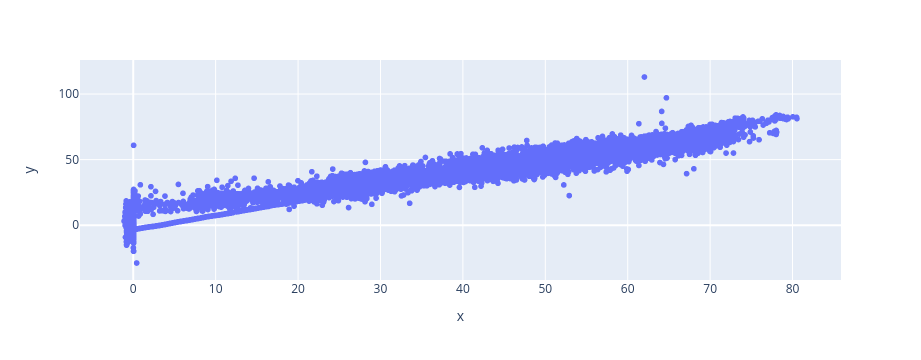

In [52]:
# El MAE obteindo es el nueve veces mayor que los modelos de gradint boost apilados. 
#
Res_Comp = pd.DataFrame(data={'actual': ydt_nrm, 
                                  'predicted': y_pred_nrm})
# h2o_compare.plot(figsize=(10, 5))
fig = px.scatter(x=Res_Comp['actual'], y=Res_Comp['predicted'])
fig.show()

In [58]:
#
X   = normalized_df.iloc[:, :-1].values  # Exclude the last column as it's the target
ydt = normalized_df.iloc[:, -1].values   # Take the last column as the target variable
n_reservoir = 100  # Number of reservoir neurons
spectral_radius = 0.8  # Magnitude of reservoir weight matrix
leak_rate = 0.5  # Leaking rate for updating the reservoir state
input_scaling = 0.2  # Scaling factor for the input weights
bias_scaling = 0.1  # Scaling factor for the bias

# Initialize the ESN weights
W_in = (np.random.rand(n_reservoir, X.shape[1]) - 0.5) * input_scaling
W_bias = (np.random.rand(n_reservoir) - 0.5) * bias_scaling
W = np.random.rand(n_reservoir, n_reservoir) - 0.5
W *= spectral_radius / np.max(np.abs(np.linalg.eigvals(W)))

# Initialize reservoir state
x = np.zeros(n_reservoir)
reservoir_state = np.zeros((n_reservoir,))

# Train the ESN
U = np.dot(X, W_in.T) + W_bias  # Input weights and biases contribution

def relu(x):
    return np.maximum(0, x)

for i in range(1, len(U)):
    current_inputs = U[i]
    reservoir_state = (1 - leak_rate) * reservoir_state + leak_rate * relu(current_inputs + 
                                                                           np.dot(reservoir_state, W))

# Concatenate input and reservoir state for regression
X_train = np.column_stack((X, np.tile(reservoir_state, (X.shape[0], 1))))

# Train a linear regression model using X_train and y
regressor = LinearRegression()
regressor.fit(X_train, ydt)

# Make predictions
predictions = regressor.predict(X_train)
y_pred_nrm  = invTransform(scaler, predictions, y, dat_tmp.columns)
ydt_nrm     = invTransform(scaler, ydt, y, dat_tmp.columns)
# Calculate Mean Absolute Error (MAE) for evaluation
mae = np.mean(np.abs(y_pred_nrm - ydt_nrm))

print(f'Mean Absolute Error: {mae}')

Mean Absolute Error: 1.5690763564118653


In [ ]:
# Poca sensibilidad a los parámetros del número de neuromas de reserva.

In [61]:
DFtest.shape

(16205, 31)

## Salvaguarda de datos para continuar con otros análisis

In [69]:
refs = {'corteT':lngcut,'varP':y,'bmodel':metalearner._id,'varsRed':lclsR}

In [70]:
#
PIK = './fase_01_datos.pkl'
with open(PIK, "wb") as f:
    pickle.dump(refs, f)
    pickle.dump(dat_unt,f)

In [68]:
metalearner._id

'metalearner_AUTO_StackedEnsemble_AllModels_2_AutoML_1_20231012_173411'